<a href="https://colab.research.google.com/github/Risto8456/Machine-Learning---Face-Recognition/blob/main/Face_Recognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 機器學習報告 - 臉部辨識
臉部辨識通常分成 4 個主要步驟：
1. 臉部偵測（Face Detection）
2. 臉部對齊（Face Alignment）
3. 臉部特徵抽取（Feature Embedding）
4. 身份比對（Face Matching）

# 第一步：臉部偵測（Face Detection）

### (1) 掛載 Google Drive、安裝套件
+ facenet-pytorch 的 MTCNN 是常用與穩定的輕量偵測器。
+ mediapipe 非常快且穩定。
+ 若要處理大量影像或即時影片，MediaPipe 較省資源、MTCNN 在小角度/傾斜上的偵測通常更穩定。
+ 可兩者比較。
+ 若未來用 RetinaFace（更準確），可改用 insightface 的 detector，但安裝與 GPU 支援較複雜。

In [ ]:
# Colab Cell 1 - 掛載 Drive 與安裝套件
from google.colab import drive
drive.mount('/content/drive')

# 安裝套件（只需執行一次）
!pip install facenet-pytorch==2.5.2       # MTCNN (人臉偵測)
!pip install mediapipe opencv-python-headless matplotlib tqdm
!pip install Pillow


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### (2) 設定路徑與載入圖片列表

In [ ]:
# Colab Cell 2 - 設定
import os, glob
from pathlib import Path

# 在 Drive 上放置圖片的資料夾
IMG_FOLDER = "/content/drive/MyDrive/Colab Notebooks/machine_learning/final/face_images"  # 圖片資料夾路徑
DETECTION_OUT_FOLDER = "/content/face_detection"       # 臉部偵測輸出資料夾路徑
os.makedirs(DETECTION_OUT_FOLDER, exist_ok=True)
os.makedirs(os.path.join(DETECTION_OUT_FOLDER, "crops"), exist_ok=True)
os.makedirs(os.path.join(DETECTION_OUT_FOLDER, "vis"), exist_ok=True)

# 取得圖片清單（支援 jpg/png）
img_paths = sorted(glob.glob(os.path.join(IMG_FOLDER, "*.[jJpP][pPnN][gG]")))

In [ ]:
print(f"Found {len(img_paths)} images, example:")
for mgp in img_paths[:5]:
    print(f"{os.path.basename(mgp)}, ")

Found 5 images, example:
1.jpg, 
2.jpg, 
3.jpg, 
4.jpg, 
5.jpg, 


### (3) MTCNN (facenet-pytorch) 偵測 + 儲存結果與可視化
+ 執行完後，會在 /content/face_detection_output/ 下看到：
  1. crops/：每個偵測到的人臉 crop 圖檔
  2. vis/：原圖加上 bounding box 與 landmarks 的可視化圖
  3. mtcnn_results.json：每張原圖的偵測清單（box、score、landmarks、crop_path）
      1. box：臉部偵測的邊界框 bounding box
      2. score：對此偵測結果的置信分數 confidence score
      3. landmarks：提供 5 個標誌點，左眼、右眼、鼻尖、左嘴角、右嘴角)
      4. crop_path：裁切後的臉部影像檔路徑

In [ ]:
# MTCNN偵測
import numpy as np
import cv2
import json
from facenet_pytorch import MTCNN
from PIL import Image
from tqdm import tqdm
import matplotlib.pyplot as plt

os.makedirs(os.path.join(DETECTION_OUT_FOLDER, "crops", "mtcnn"), exist_ok=True)
os.makedirs(os.path.join(DETECTION_OUT_FOLDER, "vis", "mtcnn"), exist_ok=True)

mtcnn = MTCNN(keep_all=True, device='cpu')  # 若有 GPU，可改 device='cuda'

results = {}  # 用來存所有圖片的偵測結果

for img_path in tqdm(img_paths, desc="MTCNN detect"):
    img_name = Path(img_path).name
    img = Image.open(img_path).convert("RGB")
    boxes, probs, landmarks = mtcnn.detect(img, landmarks=True)

    # boxes: N x 4; landmarks: N x 5 x 2 (if keep_all)
    vis = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
    items = []
    if boxes is not None:
        for i, box in enumerate(boxes):
            x1,y1,x2,y2 = [int(round(x)) for x in box]
            score = float(probs[i]) if probs is not None else None
            if score is None or score < 0.98:  # 篩掉低信心偵測，閾值可調
              continue
            kps = landmarks[i].tolist() if landmarks is not None else []
            # crop and save
            crop = vis[max(0,y1):y2, max(0,x1):x2]
            crop_path = os.path.join(DETECTION_OUT_FOLDER, "crops", "mtcnn", f"{Path(img_name).stem}_mtcnn_{i}.jpg")
            if crop.size != 0:
                cv2.imwrite(crop_path, crop)
            # 用方框標註
            cv2.rectangle(vis, (x1,y1), (x2,y2), (0,255,0), 20) # 線條粗細為 20
            if kps:
                for (lx,ly) in kps:
                    cv2.circle(vis, (int(lx), int(ly)), 20, (0,0,255), -1) # 圓點半徑為 20
            items.append({
                "box": [x1,y1,x2,y2],
                "score": score,
                "landmarks": kps,
                "crop_path": crop_path
            })
    # save visualization
    vis_path = os.path.join(DETECTION_OUT_FOLDER, "vis", "mtcnn", f"{Path(img_name).stem}_mtcnn_vis.jpg")
    cv2.imwrite(vis_path, vis)
    results[img_name] = items

# write JSON
with open(os.path.join(DETECTION_OUT_FOLDER, "mtcnn_results.json"), "w", encoding="utf-8") as f:
    json.dump(results, f, ensure_ascii=False, indent=2)

print("MTCNN results saved to:", os.path.join(DETECTION_OUT_FOLDER, "mtcnn_results.json"))

MTCNN detect: 100%|██████████| 5/5 [00:43<00:00,  8.70s/it]

MTCNN results saved to: /content/face_detection/mtcnn_results.json


### (3_2) MediaPipe 偵測版本（更快的替代方案）
| Landmark 編號 | 意義（依 MediaPipe 規格） |
| ----------- | ------------------ |
| 0           | 左眼中心               |
| 1           | 右眼中心               |
| 2           | 鼻尖                 |
| 3           | 嘴巴中心               |
| 4           | 左耳（或臉左側）           |
| 5           | 右耳（或臉右側）           |


In [ ]:
# Colab Cell 4 - MediaPipe Face Detection (single face or multiple)
import mediapipe as mp
mp_face_detection = mp.solutions.face_detection
mp_drawing = mp.solutions.drawing_utils

os.makedirs(os.path.join(DETECTION_OUT_FOLDER, "crops", "mp"), exist_ok=True)
os.makedirs(os.path.join(DETECTION_OUT_FOLDER, "vis", "mp"), exist_ok=True)

results_mp = {}
import math

with mp_face_detection.FaceDetection(model_selection=1, min_detection_confidence=0.5) as face_detector:
    for img_path in tqdm(img_paths, desc="MediaPipe detect"):
        img_name = Path(img_path).name
        orig = cv2.imread(img_path)
        img_rgb = cv2.cvtColor(orig, cv2.COLOR_BGR2RGB)
        r = face_detector.process(img_rgb)
        vis = orig.copy()
        items = []
        if r.detections:
            h, w = orig.shape[:2]
            for i, det in enumerate(r.detections):
                # bounding box
                bboxC = det.location_data.relative_bounding_box
                x1 = int(bboxC.xmin * w)
                y1 = int(bboxC.ymin * h)
                bw = int(bboxC.width * w)
                bh = int(bboxC.height * h)
                x2 = x1 + bw
                y2 = y1 + bh
                score = float(det.score[0]) if det.score else None
                if score is None or score < 0.01: # 篩掉低信心偵測，閾值可調
                  continue

                # landmarks if available (MediaPipe detection has limited landmarks)
                kps = []
                if det.location_data.relative_keypoints:
                    for kp in det.location_data.relative_keypoints:
                        kps.append([int(kp.x * w), int(kp.y * h)])

                # save crop
                crop = vis[max(0,y1):y2, max(0,x1):x2]
                crop_path = os.path.join(DETECTION_OUT_FOLDER, "crops", "mp", f"{Path(img_name).stem}_mp_{i}.jpg")
                if crop.size != 0:
                    cv2.imwrite(crop_path, crop)

                # 用方框標註
                cv2.rectangle(vis, (x1,y1), (x2,y2), (255,0,0), 20)
                for (lx,ly) in kps:
                    cv2.circle(vis, (lx,ly), 20, (0,255,255), -1)

                items.append({
                    "box": [x1,y1,x2,y2],
                    "score": score,
                    "landmarks": kps,
                    "crop_path": crop_path
                })
        vis_path = os.path.join(DETECTION_OUT_FOLDER, "vis", "mp", f"{Path(img_name).stem}_mp_vis.jpg")
        cv2.imwrite(vis_path, vis)
        results_mp[img_name] = items

with open(os.path.join(DETECTION_OUT_FOLDER, "mp_results.json"), "w", encoding="utf-8") as f:
    json.dump(results_mp, f, ensure_ascii=False, indent=2)

print("MediaPipe results saved to:", os.path.join(DETECTION_OUT_FOLDER, "mp_results.json"))


/usr/local/lib/python3.12/dist-packages/jaxlib/plugin_support.py:71: RuntimeWarning: JAX plugin jax_cuda12_plugin version 0.7.2 is installed, but it is not compatible with the installed jaxlib version 0.7.1, so it will not be used.
  warnings.warn(
MediaPipe detect: 100%|██████████| 5/5 [00:01<00:00,  2.54it/s]

MediaPipe results saved to: /content/face_detection/mp_results.json


### (4) 在 Colab 顯示幾張可視化結果（inline）

Example visualization files: ['/content/face_detection/vis/mtcnn/1_mtcnn_vis.jpg', '/content/face_detection/vis/mtcnn/2_mtcnn_vis.jpg', '/content/face_detection/vis/mtcnn/3_mtcnn_vis.jpg', '/content/face_detection/vis/mtcnn/4_mtcnn_vis.jpg', '/content/face_detection/vis/mtcnn/5_mtcnn_vis.jpg']
Displaying: 1_mtcnn_vis.jpg


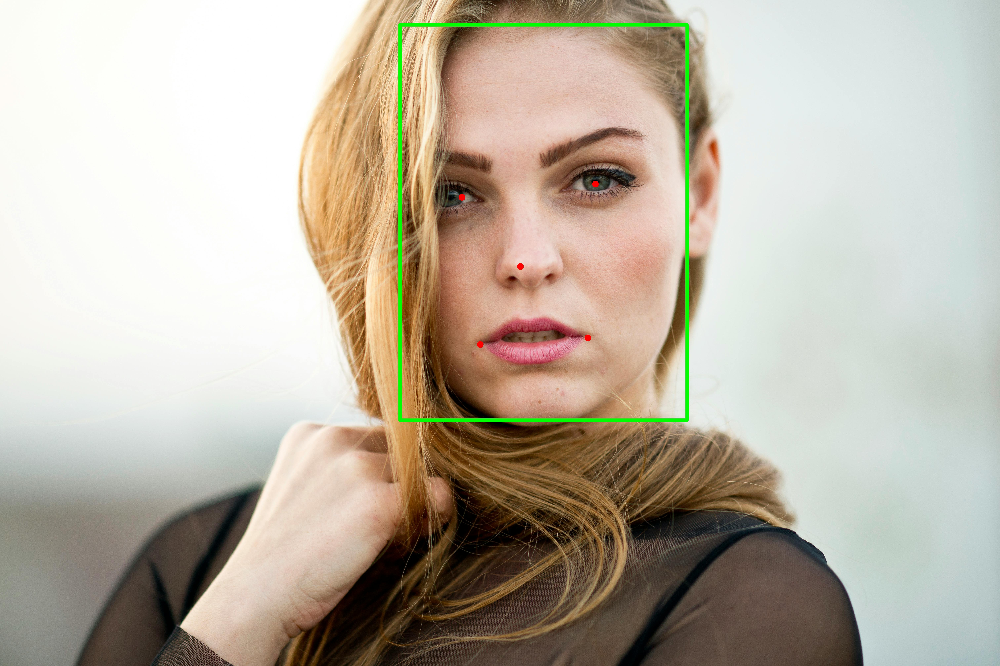

Displaying: 2_mtcnn_vis.jpg


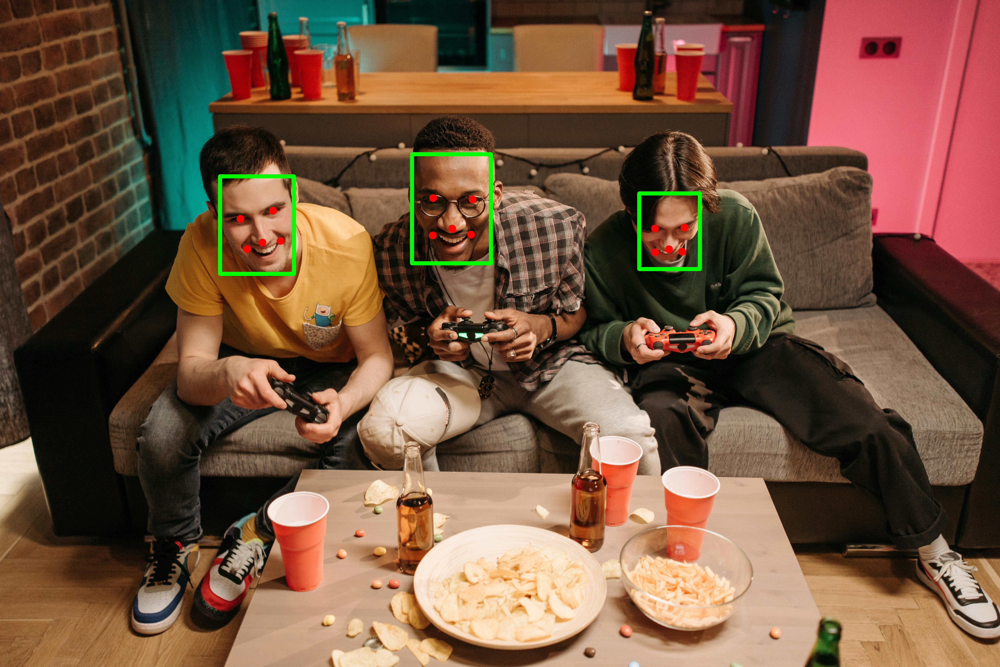

Displaying: 3_mtcnn_vis.jpg


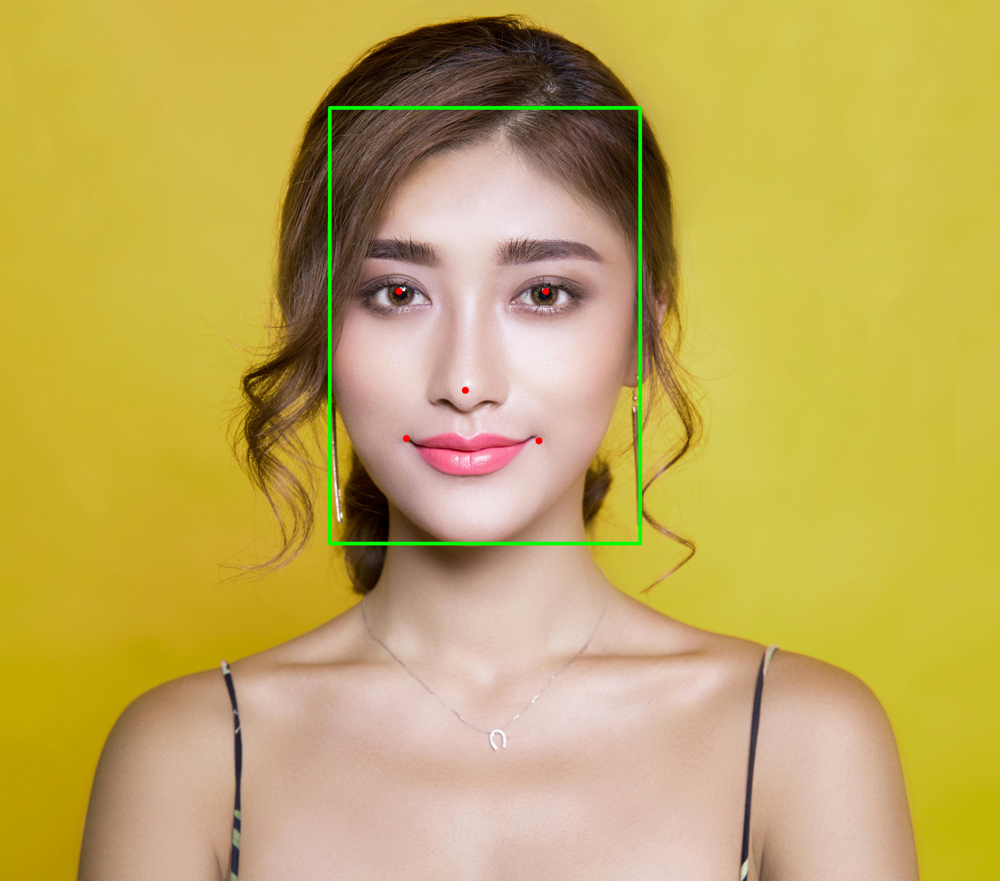

Displaying: 4_mtcnn_vis.jpg


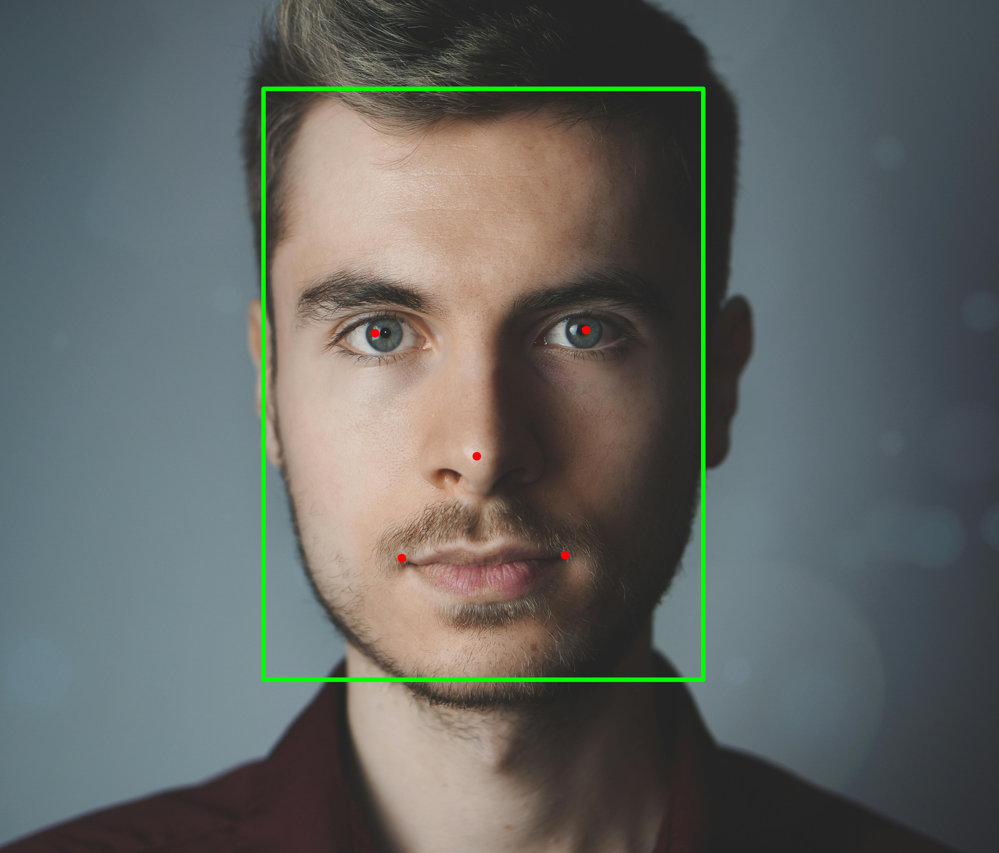

Displaying: 5_mtcnn_vis.jpg


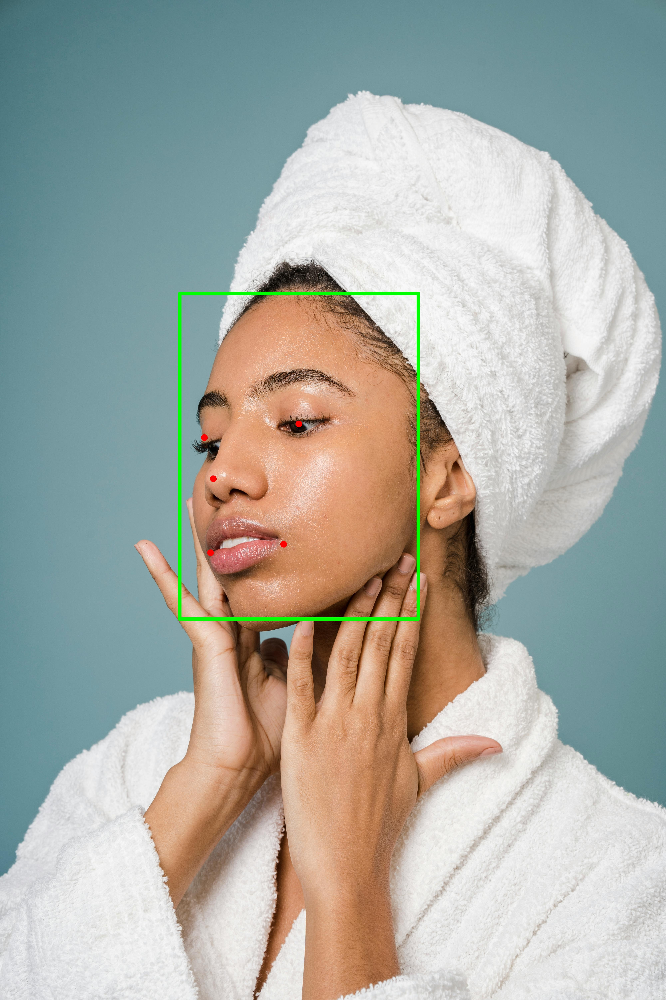

In [ ]:
# Colab Cell 5 - 顯示一些可視化結果
from IPython.display import Image, display
import os
vis_files = sorted(glob.glob(os.path.join(DETECTION_OUT_FOLDER, "vis", "mtcnn", "*_vis.jpg")))
print("Example visualization files:", vis_files[:5])
for vf in vis_files[:5]:
    print(f"Displaying: {os.path.basename(vf)}")
    display(Image(vf, width=600))

# 第二步：臉部對齊（Face Alignment）
1. 取得雙眼中間點的 landmarks (上一步已做好)
2. 計算兩個中間點與水平線的角度
3. 重新取得較大的人臉區域，並依第 2 步所得到的角度旋轉
4. 針對旋轉後的區域重新取得人臉，此即為 aligned 的人臉

### (1) 讀取 MTCNN 的偵測結果 + 取得雙眼中點
+ 上一階段輸入的 mtcnn_results.json 已含 5-point landmarks（左眼、右眼、鼻尖、嘴左、嘴右）
+ 從 landmarks 中取：
  1. 左眼中心點 (lx, ly)
  2. 右眼中心點 (rx, ry)

In [ ]:
# 1 - Step 1：讀取偵測資料，取得左右眼 landmark 的中間點

import json, os, cv2
import numpy as np
from pathlib import Path
from matplotlib import pyplot as plt

JSON_PATH = "/content/face_detection/mtcnn_results.json"  # mtcnn 結果路徑
IMG_ROOT = "/content/drive/MyDrive/Colab Notebooks/machine_learning/final/face_images" # 原圖片資料夾路徑
OUT_FOLDER = "/content/face_alignment" # 臉部對齊輸出資料夾路徑
os.makedirs(OUT_FOLDER, exist_ok=True)

with open(JSON_PATH, "r", encoding="utf-8") as f:
    det = json.load(f)

def get_eye_centers(landmarks):
    # MTCNN landmarks order: left_eye, right_eye, nose, mouth_left, mouth_right
    left_eye = np.array(landmarks[0])
    right_eye = np.array(landmarks[1])
    return left_eye, right_eye

print("Loaded", len(det), "image detections.")


# 測試印出一個圖片的眼睛座標
sample_name = list(det.keys())[0]
print("Example:", sample_name)
print("Landmarks:", det[sample_name][0]["landmarks"])
left, right = get_eye_centers(det[sample_name][0]["landmarks"])
print("Left eye:", left, "Right eye:", right)


Loaded 5 image detections.
Example: 1.jpg
Landmarks: [[2794.68408203125, 1194.08251953125], [3601.786865234375, 1114.4322509765625], [3147.53466796875, 1613.1253662109375], [2904.261474609375, 2085.305908203125], [3555.19091796875, 2045.658935546875]]
Left eye: [2794.68408203 1194.08251953] Right eye: [3601.78686523 1114.43225098]


### (2) 計算眼睛連線與水平線之角度
+ 角度公式：$θ=\arctan((y_r - y_l)/(x_r - x_l))$
+ 若右眼比較高，角度會是負；將會反過來旋轉（使眼睛變水平）。



In [ ]:
# Colab Cell #2 - Step 2：計算眼睛向量與水平線角度

def compute_angle(left_eye, right_eye):
  dx = right_eye[0] - left_eye[0]
  dy = right_eye[1] - left_eye[1]
  angle = np.degrees(np.arctan2(dy, dx))
  return angle

# 儲存所有圖片的旋轉角度
all_image_angles = {}

for img_name, detections in det.items():
  image_angles = []
  if detections:
    for face_idx, face_data in enumerate(detections):
      if "landmarks" in face_data and face_data["landmarks"]:
        left_eye, right_eye = get_eye_centers(face_data["landmarks"])
        angle = compute_angle(left_eye, right_eye)
        image_angles.append({"face_idx": face_idx, "angle": angle})
  all_image_angles[img_name] = image_angles

with open(os.path.join(OUT_FOLDER, "mtcnn_angle.json"), "w", encoding="utf-8") as f:
  json.dump(all_image_angles, f, ensure_ascii=False, indent=2)

print("Calculated rotation angles for all detected faces (first 3 images):")
# 輸出前三張圖片的角度資訊
for i, (img_name, angles) in enumerate(all_image_angles.items()):
  if i >= 3: # Limit to first 3 images
    break
  print(f"Image: {img_name}")
  if angles:
    for a in angles:
      print(f"  Face {a['face_idx']}: Rotation angle: {a['angle']:.2f} degrees")
  else:
    print("  No faces or landmarks found.")

Calculated rotation angles for all detected faces (first 3 images):
Image: 1.jpg
  Face 0: Rotation angle: -5.64 degrees
Image: 2.jpg
  Face 0: Rotation angle: 1.81 degrees
  Face 1: Rotation angle: -14.17 degrees
  Face 2: Rotation angle: -1.94 degrees
Image: 3.jpg
  Face 0: Rotation angle: 0.06 degrees


### (3) 旋轉 & 取更大的臉部區域（避免切到臉）


1. 讀取原圖
2. 以眼睛中點為旋轉中心
3. 旋轉整張圖片
4. 擴大 bounding box（讓旋轉後不會切到臉）
5. 取出旋轉後的臉部 patch



Displaying comparison for 1.jpg (Face 0): 左: 旋轉後的原始圖 (綠框為擴大區域), 右: 擴大並旋轉後的臉部裁切


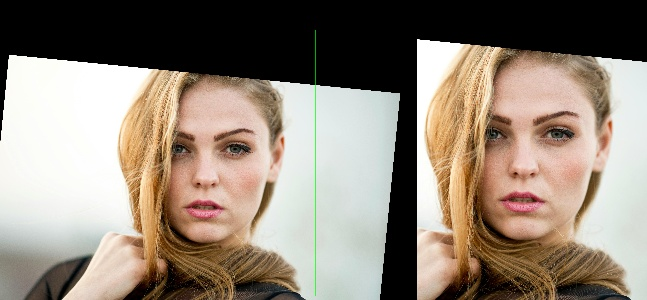

Displaying comparison for 2.jpg (Face 0): 左: 旋轉後的原始圖 (綠框為擴大區域), 右: 擴大並旋轉後的臉部裁切


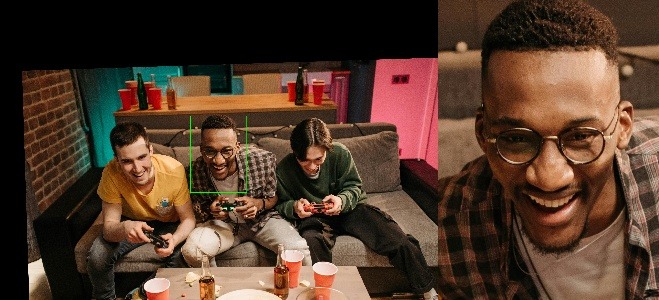

Displaying comparison for 2.jpg (Face 1): 左: 旋轉後的原始圖 (綠框為擴大區域), 右: 擴大並旋轉後的臉部裁切


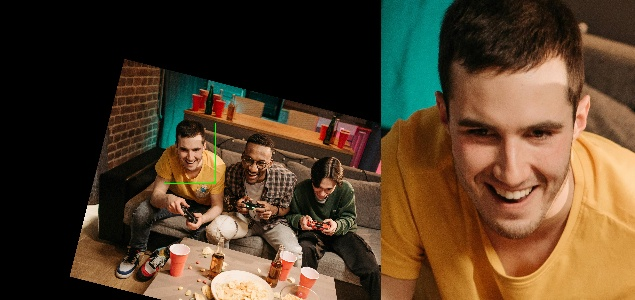

Displaying comparison for 2.jpg (Face 2): 左: 旋轉後的原始圖 (綠框為擴大區域), 右: 擴大並旋轉後的臉部裁切


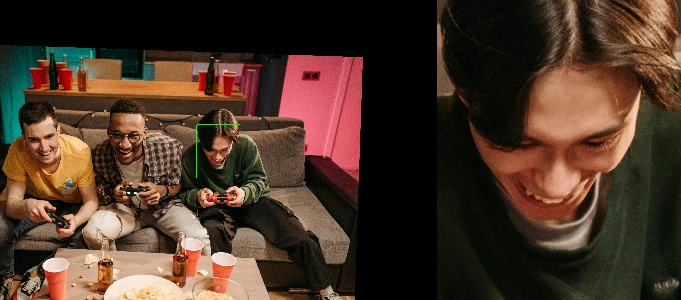

Displaying comparison for 3.jpg (Face 0): 左: 旋轉後的原始圖 (綠框為擴大區域), 右: 擴大並旋轉後的臉部裁切


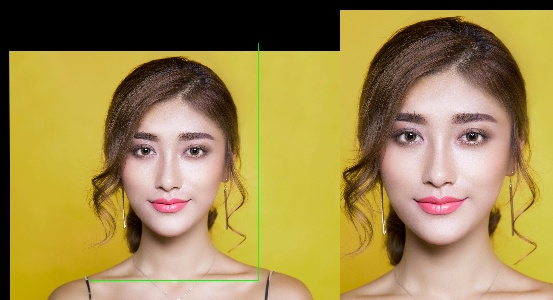

所有擴大並旋轉後的臉部裁切已處理完成。結果儲存於 /content/face_alignment_expanded_crops/expanded_crop_results.json
前 3 張原始圖片的比較圖已顯示於上方。


In [ ]:
# Colab Cell #3 - Step 3：旋轉原圖並擴大 bbox (處理所有偵測到的人臉)

import os, json, cv2
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt
from IPython.display import Image, display # For inline display
import glob # For image path lookup

# --- 載入前一步驟的偵測結果與角度資訊 ---
DET_JSON = "/content/face_detection/mtcnn_results.json" # 偵測結果
ANGLE_JSON = "/content/face_alignment/mtcnn_angle.json" # 角度資訊 mtcnn_angle.json
IMG_ROOT = "/content/drive/MyDrive/Colab Notebooks/machine_learning/final/face_images" # Original image folder path

OUT_ALIGNED_EXPANDED_CROP = "/content/face_alignment_expanded_crops"
os.makedirs(OUT_ALIGNED_EXPANDED_CROP, exist_ok=True)
expanded_crops_dir = os.path.join(OUT_ALIGNED_EXPANDED_CROP, "crops")
vis_dir_expanded_crop = os.path.join(OUT_ALIGNED_EXPANDED_CROP, "vis")
os.makedirs(expanded_crops_dir, exist_ok=True)
os.makedirs(vis_dir_expanded_crop, exist_ok=True)

# Helper function to get eye centers
def get_eye_centers(landmarks):
    # MTCNN landmarks order: left_eye, right_eye, nose, mouth_left, mouth_right
    left_eye = np.array(landmarks[0], dtype=np.float32)
    right_eye = np.array(landmarks[1], dtype=np.float32)
    return left_eye, right_eye

# Load detection results
with open(DET_JSON, "r", encoding="utf-8") as f:
    det_results = json.load(f)

# Load angle information
with open(ANGLE_JSON, "r", encoding="utf-8") as f:
    all_image_angles = json.load(f)

# --- Helper functions (copied and adapted for this cell) ---
def clamp(v, low, high):
    return max(low, min(high, v))

def rotate_image(img, angle_deg, center=None):
    # This version correctly handles expanded canvas to prevent cropping
    (h, w) = img.shape[:2]
    if center is None:
        center = (w//2, h//2)
    M = cv2.getRotationMatrix2D(tuple(center), angle_deg, 1.0)
    # compute new image size to prevent cropping after rotation
    cos = np.abs(M[0,0]); sin = np.abs(M[0,1])
    nw = int((h * sin) + (w * cos))
    nh = int((h * cos) + (w * sin))
    # adjust rotation matrix to take into account the new canvas size translation
    M[0,2] += (nw / 2) - center[0]
    M[1,2] += (nh / 2) - center[1]
    rotated = cv2.warpAffine(img, M, (nw, nh), flags=cv2.INTER_LINEAR, borderValue=(0,0,0))
    return rotated, M

def transform_point(pt, M):
    x,y = pt
    # Apply affine transform matrix M
    tx = M[0,0]*x + M[0,1]*y + M[0,2]
    ty = M[1,0]*x + M[1,1]*y + M[1,2]
    return [tx, ty] # Return floats, convert to int when needed

def enlarge_box(box, scale=1.5):
    # This function calculates an enlarged box, does not clamp
    x1, y1, x2, y2 = box
    w = x2 - x1
    h = y2 - y1
    cx = x1 + w/2
    cy = y1 + h/2
    new_w = w * scale
    new_h = h * scale
    nx1 = cx - new_w/2
    ny1 = cy - new_h/2
    nx2 = cx + new_w/2
    ny2 = cy + new_h/2
    return [nx1, ny1, nx2, ny2]


# --- Prepare image path lookup ---
POSSIBLE_IMG_DIRS = [
    IMG_ROOT, # '/content/drive/MyDrive/Colab Notebooks/machine_learning/final/face_images'
    "/content/drive/MyDrive/face_images",
    "/content/face_images",
    "/content/drive/MyDrive",
    "/content"
]
image_path_lookup = {}
for img_name in det_results.keys():
    found_path = None
    for d in POSSIBLE_IMG_DIRS:
        p = os.path.join(d, img_name)
        if os.path.exists(p):
            found_path = p
            break
    if found_path is None:
        matches = glob.glob(f"/content/**/{img_name}", recursive=True)
        found_path = matches[0] if matches else None
    image_path_lookup[img_name] = found_path

missing_images = [k for k,v in image_path_lookup.items() if v is None]
if len(missing_images) > 0:
    print("警告：以下影像檔案找不到原始圖片（請確認路徑或把圖放到指定資料夾）:")
    print(missing_images[:10])


# --- Process all faces ---
expanded_crop_results = {}
processed_original_images_count = 0 # This counter tracks how many *original images* we have processed for display purposes.

for img_name, faces in det_results.items():
    expanded_crop_results[img_name] = []

    original_full_img_path = image_path_lookup.get(img_name)
    if original_full_img_path is None:
        print(f"警告: 找不到 {img_name} 的原始影像檔案。跳過此圖片的處理。")
        continue

    orig = cv2.imread(original_full_img_path)
    if orig is None:
        print(f"警告: 無法讀取 {original_full_img_path}。跳過此圖片的處理。")
        continue
    ih, iw = orig.shape[:2]

    # Get angles for this image from the loaded all_image_angles
    current_image_angles = {f_data['face_idx']: f_data['angle'] for f_data in all_image_angles.get(img_name, [])}

    for idx, face_data in enumerate(faces):
        box = face_data.get('box') # [x1,y1,x2,y2] in original image coordinates
        landmarks = face_data.get('landmarks') # Absolute coordinates

        if box is None or not landmarks or len(landmarks) < 2:
            print(f"警告: {img_name} 中編號 {idx} 的人臉偵測缺少 box 或 landmarks。跳過此人臉。")
            expanded_crop_results[img_name].append({
                "face_idx": idx,
                "status": "skipped_invalid_detection"
            })
            continue

        # Get eye centers for rotation center (needs to be np.array for get_eye_centers)
        left_eye_np, right_eye_np = get_eye_centers(landmarks)
        mid_eye = ((left_eye_np + right_eye_np) / 2.0).tolist() # Convert to list for tuple(center) in cv2.getRotationMatrix2D

        # Get rotation angle for this specific face
        rotation_angle_for_this_face = current_image_angles.get(idx, 0.0) # Default to 0 if not found

        # 1. Rotate the original image around the eye center
        rotated_img, M_rot = rotate_image(orig, rotation_angle_for_this_face, center=tuple(mid_eye))

        # 2. Transform the original bounding box corners to the rotated image's coordinate system
        orig_corners = np.array([
            [box[0], box[1]], # top-left
            [box[2], box[1]], # top-right
            [box[2], box[3]], # bottom-right
            [box[0], box[3]]  # bottom-left
        ], dtype=np.float32)

        # Apply transformation to each corner
        transformed_corners = np.array([transform_point(pt, M_rot) for pt in orig_corners], dtype=np.float32)

        # Calculate the new bounding box in rotated image coordinates
        min_x = np.min(transformed_corners[:, 0])
        max_x = np.max(transformed_corners[:, 0])
        min_y = np.min(transformed_corners[:, 1])
        max_y = np.max(transformed_corners[:, 1])
        transformed_bbox = [min_x, min_y, max_x, max_y]

        # 3. Enlarge the transformed bounding box
        scale_factor = 1.6
        big_box_rotated_float = enlarge_box(transformed_bbox, scale=scale_factor)
        big_box_rotated = [int(round(x)) for x in big_box_rotated_float] # Convert to int

        # 4. Clamp big_box_rotated coordinates to the dimensions of rotated_img
        bx1, by1, bx2, by2 = big_box_rotated
        bx1 = clamp(bx1, 0, rotated_img.shape[1] - 1)
        by1 = clamp(by1, 0, rotated_img.shape[0] - 1)
        bx2 = clamp(bx2, 0, rotated_img.shape[1]) # x2 can be img.shape[1] if it refers to exclusive end
        by2 = clamp(by2, 0, rotated_img.shape[0]) # y2 can be img.shape[0] if it refers to exclusive end

        # Ensure valid crop dimensions
        if bx2 <= bx1 or by2 <= by1:
            print(f"警告: {img_name} 中編號 {idx} 的擴大旋轉邊界框無效 ({bx1},{by1},{bx2},{by2})。跳過此人臉裁切。")
            expanded_crop_results[img_name].append({
                "face_idx": idx,
                "status": "skipped_invalid_crop_dimensions"
            })
            continue

        # 5. Crop the expanded and rotated face region
        crop_big = rotated_img[by1:by2, bx1:bx2].copy()

        if crop_big.size == 0:
            print(f"警告: {img_name} 中編號 {idx} 的擴大旋轉裁切結果為空。跳過此人臉裁切。")
            expanded_crop_results[img_name].append({
                "face_idx": idx,
                "status": "skipped_empty_crop"
            })
            continue

        # Save the expanded and rotated face crop
        crop_big_path = os.path.join(expanded_crops_dir, f"{Path(img_name).stem}_expanded_rot_{idx}.jpg")
        cv2.imwrite(crop_big_path, crop_big)

        # Store metadata
        expanded_crop_results[img_name].append({
            "face_idx": idx,
            "orig_img_name": img_name,
            "original_box": box,
            "mid_eye_original_coords": mid_eye,
            "rotation_angle_deg": rotation_angle_for_this_face,
            "transformed_bbox_in_rotated_img": [int(min_x), int(min_y), int(max_x), int(max_y)],
            "expanded_rotated_crop_box": [bx1, by1, bx2, by2],
            "expanded_rotated_crop_path": crop_big_path,
            "status": "processed"
        })

        # --- 條件視覺化（僅適用於前 3 張原始影像） ---
        if processed_original_images_count < 3:
            # 建立旋轉後的影像副本，用於在其上繪製邊界框以進行視覺化。
            vis_rotated_img = rotated_img.copy()
            # 在旋轉後的完整影像上繪製放大旋轉後的邊界框。
            cv2.rectangle(vis_rotated_img, (bx1, by1), (bx2, by2), (0, 255, 0), max(1, int(rotated_img.shape[0]/500))) # Green box

            # 準備用於水平堆疊的影像（調整大小為共同的顯示高度）
            target_display_h = 300 # 合適的高度，便於展示對比影像

            if vis_rotated_img.shape[0] > 0 and vis_rotated_img.shape[1] > 0:
                ratio_vis_rot = target_display_h / vis_rotated_img.shape[0]
                vis_rotated_img_resized = cv2.resize(vis_rotated_img, (int(vis_rotated_img.shape[1] * ratio_vis_rot), target_display_h))
            else:
                vis_rotated_img_resized = np.zeros((target_display_h, target_display_h, 3), dtype=np.uint8)

            if crop_big.shape[0] > 0 and crop_big.shape[1] > 0:
                ratio_crop_big = target_display_h / crop_big.shape[0]
                crop_big_resized = cv2.resize(crop_big, (int(crop_big.shape[1] * ratio_crop_big), target_display_h))
            else:
                crop_big_resized = np.zeros((target_display_h, target_display_h, 3), dtype=np.uint8)

            # 確保兩張圖片的高度（hstack）完全相同（必要時可添加內邊距）。
            max_h_current = max(vis_rotated_img_resized.shape[0], crop_big_resized.shape[0])
            if vis_rotated_img_resized.shape[0] < max_h_current:
                pad_h = max_h_current - vis_rotated_img_resized.shape[0]
                vis_rotated_img_resized = cv2.copyMakeBorder(vis_rotated_img_resized, 0, pad_h, 0, 0, cv2.BORDER_CONSTANT, value=(0,0,0))
            if crop_big_resized.shape[0] < max_h_current:
                pad_h = max_h_current - crop_big_resized.shape[0]
                crop_big_resized = cv2.copyMakeBorder(crop_big_resized, 0, pad_h, 0, 0, cv2.BORDER_CONSTANT, value=(0,0,0))


            vis_comparison = np.hstack((vis_rotated_img_resized, crop_big_resized))
            vis_path = os.path.join(vis_dir_expanded_crop, f"{Path(img_name).stem}_face_{idx}_comp.jpg")
            cv2.imwrite(vis_path, vis_comparison)

            print(f"Displaying comparison for {img_name} (Face {idx}): 左: 旋轉後的原始圖 (綠框為擴大區域), 右: 擴大並旋轉後的臉部裁切")
            display(Image(vis_path, width=700))

    # 處理完該影像的所有面之後，原始影像的計數器會遞增。
    if processed_original_images_count < 3: # 只有在仍在顯示限制範圍內時才增加數值。
        processed_original_images_count += 1


# Save the final results dictionary
results_json_path = os.path.join(OUT_ALIGNED_EXPANDED_CROP, "expanded_crop_results.json")
with open(results_json_path, "w", encoding="utf-8") as f:
    json.dump(expanded_crop_results, f, ensure_ascii=False, indent=2)

print(f"所有擴大並旋轉後的臉部裁切已處理完成。結果儲存於 {results_json_path}")
print(f"前 {min(len(det_results), 3)} 張原始圖片的比較圖已顯示於上方。") # min(len(det_results), 3) to accurately reflect how many original images were processed and displayed.


### (4) 在旋轉後的大區域再次做人臉偵測
1. 將 crop_big 再丟回 MTCNN detect
2. 得到全新的 bbox（就是 aligned face）
3. 儲存 aligned face 圖片
4. 產生下一步 embedding 所需的資料

Re-detecting faces in expanded crops:   0%|          | 0/5 [00:00<?, ?it/s]

Displaying final aligned face for 1.jpg (Face 0): 左: 擴大並旋轉後的區域, 右: 重新偵測並對齊的人臉


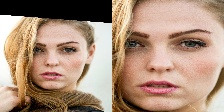

Re-detecting faces in expanded crops:  20%|██        | 1/5 [00:08<00:32,  8.25s/it]

Displaying final aligned face for 2.jpg (Face 0): 左: 擴大並旋轉後的區域, 右: 重新偵測並對齊的人臉


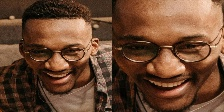

Displaying final aligned face for 2.jpg (Face 1): 左: 擴大並旋轉後的區域, 右: 重新偵測並對齊的人臉


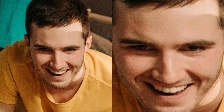

Displaying final aligned face for 2.jpg (Face 2): 左: 擴大並旋轉後的區域, 右: 重新偵測並對齊的人臉


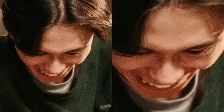

Re-detecting faces in expanded crops:  40%|████      | 2/5 [00:09<00:12,  4.29s/it]

Displaying final aligned face for 3.jpg (Face 0): 左: 擴大並旋轉後的區域, 右: 重新偵測並對齊的人臉


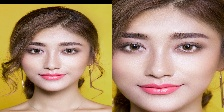

Re-detecting faces in expanded crops: 100%|██████████| 5/5 [00:29<00:00,  5.80s/it]

所有重新偵測並對齊後的臉部已處理完成。結果儲存於 /content/face_alignment_redetect/final_aligned_results.json
前 5 張圖片的最終對齊範例已顯示於上方。


In [ ]:
# Colab Cell #4 - Step 4：對旋轉後的裁切區域重新做人臉偵測 (Aligned Face)

import os, json
import numpy as np
import cv2
from facenet_pytorch import MTCNN
from PIL import Image as PILImage # Use alias to avoid conflict with IPython.display.Image
import matplotlib.pyplot as plt
from pathlib import Path
from tqdm import tqdm
from IPython.display import Image, display

# --- 輸出設定 ---
OUT_DIR_ALIGNED_REDO = "/content/face_alignment_redetect"
os.makedirs(OUT_DIR_ALIGNED_REDO, exist_ok=True)
aligned_faces_dir = os.path.join(OUT_DIR_ALIGNED_REDO, "aligned_faces")
os.makedirs(aligned_faces_dir, exist_ok=True)
vis_aligned_dir = os.path.join(OUT_DIR_ALIGNED_REDO, "vis_aligned")
os.makedirs(vis_aligned_dir, exist_ok=True)

# --- 輸入設定 ---
# 載入前一步驟 (wiyQIjBDzFBc) 產生的擴大並旋轉後的裁切結果
EXPANDED_CROPS_JSON = "/content/face_alignment_expanded_crops/expanded_crop_results.json"

# --- 模型設定 ---
mtcnn = MTCNN(keep_all=False, device='cpu')  # keep_all=False because we expect one main face per crop_big
OUT_FACE_SIZE = (112, 112) # Standard size for aligned faces

# --- 載入 expanded_crop_results ---
with open(EXPANDED_CROPS_JSON, "r", encoding="utf-8") as f:
    expanded_crop_results = json.load(f)

final_aligned_results = {}
num_displayed_examples = 0 # Counter for display examples

# 遍歷所有圖片和其中偵測到的人臉
for img_name, faces_data_list in tqdm(expanded_crop_results.items(), desc="Re-detecting faces in expanded crops"):
    final_aligned_results[img_name] = []

    for idx, face_data in enumerate(faces_data_list):
        if face_data.get("status") != "processed":
            # Skip if the previous step already marked it as skipped
            final_aligned_results[img_name].append({
                "face_idx": idx,
                "status": face_data.get("status", "skipped")
            })
            continue

        crop_big_path = face_data["expanded_rotated_crop_path"]
        original_box = face_data["original_box"] # For reference

        crop_big = cv2.imread(crop_big_path)
        if crop_big is None or crop_big.size == 0:
            print(f"警告: 無法讀取擴大旋轉後的裁切影像 {crop_big_path}。跳過此人臉的重新偵測。")
            final_aligned_results[img_name].append({
                "face_idx": idx,
                "status": "skipped_cannot_read_crop_big"
            })
            continue

        # Convert to RGB PIL Image for MTCNN detection
        rgb_crop_big = cv2.cvtColor(crop_big, cv2.COLOR_BGR2RGB)
        pil_img_crop_big = PILImage.fromarray(rgb_crop_big)

        # 在旋轉後的裁切區域重新做人臉偵測
        aligned_boxes, aligned_probs, aligned_landmarks = mtcnn.detect(
            pil_img_crop_big,
            landmarks=True
        )

        if aligned_boxes is not None and len(aligned_boxes) > 0:
            # 取第一個偵測到的人臉（因為 crop_big 理論上只有一個人臉）
            ax1, ay1, ax2, ay2 = [int(round(x)) for x in aligned_boxes[0]]
            score = float(aligned_probs[0]) if aligned_probs is not None else None
            kps = aligned_landmarks[0].tolist() if aligned_landmarks is not None else []

            # 裁切最終對齊人臉
            final_aligned_face_raw = crop_big[max(0,ay1):ay2, max(0,ax1):ax2]

            if final_aligned_face_raw.size == 0:
                print(f"警告: {img_name} (Face {idx}) 最終對齊裁切結果為空。使用空白圖片替代。")
                final_aligned_face_resized = np.zeros((OUT_FACE_SIZE[1], OUT_FACE_SIZE[0], 3), dtype=np.uint8)
            else:
                final_aligned_face_resized = cv2.resize(final_aligned_face_raw, OUT_FACE_SIZE)

            # 儲存最終對齊人臉
            final_aligned_path = os.path.join(aligned_faces_dir, f"{Path(img_name).stem}_final_aligned_{idx}.jpg")
            cv2.imwrite(final_aligned_path, final_aligned_face_resized)

            # 儲存結果到 final_aligned_results
            final_aligned_results[img_name].append({
                "face_idx": idx,
                "original_box": original_box, # Original box from first detection
                "expanded_rotated_crop_path": crop_big_path, # Path to the intermediate crop_big
                "aligned_face_bbox_in_crop_big": [ax1, ay1, ax2, ay2], # Bbox relative to crop_big
                "aligned_face_score": score,
                "aligned_face_landmarks_in_crop_big": kps,
                "final_aligned_path": final_aligned_path,
                "rotation_angle_deg": face_data.get("rotation_angle_deg"), # angle from prev step
                "status": "processed"
            })

            # 顯示前N個範例 (例如前5個)
            if num_displayed_examples < 5:
                vis_path_current = os.path.join(vis_aligned_dir, f"{Path(img_name).stem}_final_aligned_vis_{idx}.jpg")
                # Create a comparison: crop_big (rotated enlarged) vs final_aligned_face_resized
                # Resize crop_big to make it visually comparable for hstack
                crop_big_display = cv2.resize(crop_big, (OUT_FACE_SIZE[0], OUT_FACE_SIZE[1]))
                vis_comparison = np.hstack((crop_big_display, final_aligned_face_resized))
                cv2.imwrite(vis_path_current, vis_comparison)

                print(f"Displaying final aligned face for {img_name} (Face {idx}): 左: 擴大並旋轉後的區域, 右: 重新偵測並對齊的人臉")
                display(Image(vis_path_current, width=400))
                num_displayed_examples += 1

        else:
            print(f"警告: 在 {img_name} (Face {idx}) 的擴大旋轉區域中未偵測到人臉。跳過此人臉的最終對齊。")
            final_aligned_results[img_name].append({
                "face_idx": idx,
                "status": "skipped_no_face_in_rotated_crop",
                "original_box": original_box,
                "expanded_rotated_crop_path": crop_big_path,
                "rotation_angle_deg": face_data.get("rotation_angle_deg")
            })

# --- 儲存最終的對齊結果 JSON ---
final_results_json_path = os.path.join(OUT_DIR_ALIGNED_REDO, "final_aligned_results.json")
with open(final_results_json_path, "w", encoding="utf-8") as f:
    json.dump(final_aligned_results, f, ensure_ascii=False, indent=2)

print(f"所有重新偵測並對齊後的臉部已處理完成。結果儲存於 {final_results_json_path}")
print(f"前 {min(num_displayed_examples, len(expanded_crop_results))} 張圖片的最終對齊範例已顯示於上方。")


# 第三步：臉部特徵抽取（Face Embedding）
+ 輸入：在上一階段輸出的 aligned face：aligned_face_path
+ 輸出：一張臉的 512維 embedding，可儲存成 .json、.npy 或存進資料庫
+ 下一步（比對）只需拿 distance 做比較即可

### (1) 安裝 InsightFace 及依賴

In [ ]:
!pip install insightface
!pip install onnxruntime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 439.5/439.5 kB 6.9 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.2/18.2 MB 79.8 MB/s eta 0:00:00
  Created wheel for insightface: filename=insightface-0.7.3-cp312-cp312-linux_x86_64.whl size=1071343 sha256=4babed77f42975cdb43c48b0945ac2f12313cab9bd3d2b168f6a381d30e42bdb
  Stored in directory: /root/.cache/pip/wheels/73/3c/e2/6d4815e8a8b33a2006554d65ce0d1f973e768f4c7a222fa675
Successfully built insightface
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.4/17.4 MB 74.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 7.3 MB/s eta 0:00:00


### (2) 載入 ArcFace 模型
ArcFace (buffalo_l) 特點：
1. 512-d embedding
2. RetinaFace detector + ArcFace embedding
3. 高準確度（LFW > 99.8%）

In [ ]:
from insightface.app import FaceAnalysis

# ctx_id = 0 -> 使用 GPU；如果你沒有 GPU 改成 -1
app = FaceAnalysis(name="buffalo_l", root="/content/.insightface")
app.prepare(ctx_id=0)


download_path: /content/.insightface/models/buffalo_l


100%|██████████| 281857/281857 [00:04<00:00, 65404.80KB/s] 
/usr/local/lib/python3.12/dist-packages/onnxruntime/capi/onnxruntime_inference_collection.py:123: UserWarning: Specified provider 'CUDAExecutionProvider' is not in available provider names.Available providers: 'AzureExecutionProvider, CPUExecutionProvider'
  warnings.warn(


Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /content/.insightface/models/buffalo_l/1k3d68.onnx landmark_3d_68 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /content/.insightface/models/buffalo_l/2d106det.onnx landmark_2d_106 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /content/.insightface/models/buffalo_l/det_10g.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /content/.insightface/models/buffalo_l/genderage.onnx genderage ['None', 3, 96, 96] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /content/.insightface/models/buffalo_l/w600k_r50.onnx recognition ['None', 3, 112, 112] 127.5 127.5
set det-size: (640, 64

### (3) 讀取 aligned face 並取得 embedding

In [ ]:
import cv2
import numpy as np
import json

ALIGNED_FACE_PATH = "/content/aligned_face.jpg"  # 修改成上一階段輸出的路徑

img = cv2.imread(ALIGNED_FACE_PATH)
faces = app.get(img)

if len(faces) == 0:
    raise ValueError("No face detected in aligned face image!")

face = faces[0]
embedding = face.embedding  # ndarray, shape (512,)

print("Embedding shape:", embedding.shape)
print("First 10 values:", embedding[:10])


# 偵測+對齊精簡版

In [ ]:
# 掛載 Drive 與安裝套件
from google.colab import drive
drive.mount('/content/drive')

# 安裝套件（只需執行一次）
!pip install facenet-pytorch==2.5.2       # MTCNN (人臉偵測)
!pip install mediapipe opencv-python-headless matplotlib tqdm
!pip install Pillow


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## 臉部偵測，儲存資訊(box、score、landmarks、crop_path)

In [ ]:
import os, glob
from pathlib import Path

# 資料夾路徑與設定
IMG_FOLDER = "/content/drive/MyDrive/Colab Notebooks/machine_learning/final/face_images"  # 原圖資料夾路徑
DET_OUT_FOLDER = "/content/face_detection" # 臉部偵測輸出資料夾路徑
os.makedirs(DET_OUT_FOLDER, exist_ok=True)

# MTCNN偵測
import numpy as np
import cv2
import json
from facenet_pytorch import MTCNN
from PIL import Image
from tqdm import tqdm
import matplotlib.pyplot as plt
mtcnn = MTCNN(keep_all=True, device='cpu')  # 若有 GPU，可改 device='cuda'

# 給予圖片資料夾路徑，回傳臉部辨識資訊
def mtcnn_detect(img_folder):
  # 取得圖片清單（支援 jpg/png）
  img_paths = sorted(glob.glob(os.path.join(img_folder, "*.[jJpP][pPnN][gG]")))
  print(f"Found {len(img_paths)} images, example:")

  results = {}  # 用來存所有圖片的偵測結果
  for img_path in tqdm(img_paths, desc="MTCNN detect"):
    img_name = Path(img_path).name
    img = Image.open(img_path).convert("RGB")
    boxes, probs, landmarks = mtcnn.detect(img, landmarks=True)

    # boxes: N x 4; landmarks: N x 5 x 2 (if keep_all)
    vis = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
    items = []
    if boxes is not None:
      for i, box in enumerate(boxes):
        x1,y1,x2,y2 = [int(round(x)) for x in box]
        score = float(probs[i]) if probs is not None else None
        if score is None or score < 0.98:  # 篩掉低信心偵測，閾值可調
          continue
        kps = landmarks[i].tolist() if landmarks is not None else []
        items.append({
          "box": [x1,y1,x2,y2],
          "score": score,
          "landmarks": kps
        })
    results[img_name] = items
  return results

# 寫入 JSON
results = mtcnn_detect(IMG_FOLDER)
with open(os.path.join(DET_OUT_FOLDER, "mtcnn_results.json"), "w", encoding="utf-8") as f:
  json.dump(results, f, ensure_ascii=False, indent=2)

print("\nMTCNN results saved to:", os.path.join(DET_OUT_FOLDER, "mtcnn_results.json"))


Found 5 images, example:


MTCNN detect: 100%|██████████| 5/5 [01:07<00:00, 13.49s/it]


MTCNN results saved to: /content/face_detection/mtcnn_results.json


In [ ]:
# 測試輸出
import json
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image, display
from PIL import Image as PILImage # 使用別名以避免與 IPython.display.Image 衝突

# --- 設定 ---
DET_JSON = "/content/face_detection/mtcnn_results.json"  # MTCNN 臉部偵測結果路徑
IMG_FOLDER = "/content/drive/MyDrive/Colab Notebooks/machine_learning/final/face_images" # 原始圖片資料夾路徑

# --- 載入偵測結果 ---
with open(DET_JSON, "r", encoding="utf-8") as f:
  det_results = json.load(f)
print(f"成功載入 {len(det_results)} 張圖片的偵測結果。")

# --- 視覺化前 3 張圖片的偵測結果 ---
print("視覺化前 3 張圖片的偵測結果")
num_displayed_images = 0
for img_name, faces in det_results.items():
  if num_displayed_images >= 3:
    break

  img_path = os.path.join(IMG_FOLDER, img_name)
  if not os.path.exists(img_path):
    print(f"警告: 找不到原始影像檔案: {img_path}。跳過此圖片顯示。")
    continue

  # 載入原始圖片
  orig_img = cv2.imread(img_path)
  if orig_img is None:
    print(f"警告: 無法讀取原始影像: {img_path}。跳過此圖片顯示。")
    continue

  # 建立一個副本以進行繪圖 (BGR 格式)
  vis_img = orig_img.copy()

  if faces:
    for face_data in faces:
      box = face_data.get('box') # [x1,y1,x2,y2]
      landmarks = face_data.get('landmarks') # [x,y] 點的列表

      if box is None or not landmarks:
        continue # 如果缺少邊界框或地標，則跳過

      x1, y1, x2, y2 = [int(val) for val in box] # 確保整數座標

      # 繪製邊界框
      cv2.rectangle(vis_img, (x1, y1), (x2, y2), (0, 255, 0), 20) # 綠色框，粗細 20

      # 繪製地標
      if landmarks:
        for lx, ly in landmarks:
          cv2.circle(vis_img, (int(lx), int(ly)), 20, (0, 0, 255), -1) # 紅色圓點，半徑 20，實心

  # 將 BGR 轉換為 RGB 以用於 matplotlib/PIL 顯示
  vis_img_rgb = cv2.cvtColor(vis_img, cv2.COLOR_BGR2RGB)

  # 使用 matplotlib 顯示 (或 PIL 如果直接用於 IPython.display.Image)
  plt.figure(figsize=(10, 10)) # 根據需要調整圖片大小
  plt.imshow(vis_img_rgb)
  plt.title(f'Faces detected on {img_name}')
  plt.axis('off') # 隱藏軸線
  plt.show()

  num_displayed_images += 1

print("展示完畢。")

## 臉部對齊，儲存臉部對齊結果圖片

In [ ]:
import json, os, cv2
import numpy as np
from pathlib import Path
import matplotlib.pyplot as plt

DET_JSON = "/content/face_detection/mtcnn_results.json"  # mtcnn 臉部偵測結果路徑
ALI_OUT_FOLDER = "/content/face_alignment" # 臉部對齊結果輸出資料夾路徑
os.makedirs(ALI_OUT_FOLDER, exist_ok=True)

# 讀取偵測資料
with open(DET_JSON, "r", encoding="utf-8") as f:
  det = json.load(f)
print("Loaded", len(det), "image detections.")

# 取得左眼與右眼的 landmark
def get_eye_centers(landmarks):
  # MTCNN landmarks order: left_eye, right_eye, nose, mouth_left, mouth_right
  left_eye = np.array(landmarks[0])
  right_eye = np.array(landmarks[1])
  return left_eye, right_eye

# 計算眼睛向量與水平線角度
def compute_angle(left_eye, right_eye):
  dx = right_eye[0] - left_eye[0]
  dy = right_eye[1] - left_eye[1]
  angle = np.degrees(np.arctan2(dy, dx))
  return angle

# 修改 det 字典，加入 face_idx 和 angle
for img_name, detections in det.items():
  if detections:
    for face_idx, face_data in enumerate(detections):
      face_data["face_idx"] = face_idx # Add face_idx
      if "landmarks" in face_data and face_data["landmarks"]:
        left_eye, right_eye = get_eye_centers(face_data["landmarks"])
        angle = compute_angle(left_eye, right_eye)
        face_data["angle"] = angle # 為臉部資料添加角度
      else:
        face_data["angle"] = None # 如果沒有地標，則無法計算角度。

# 儲存修改後的 det 字典
OUTPUT_JSON_PATH = os.path.join(ALI_OUT_FOLDER, "mtcnn_results_with_angle.json") # New output file name
with open(OUTPUT_JSON_PATH, "w", encoding="utf-8") as f:
  json.dump(det, f, ensure_ascii=False, indent=2)

Loaded 5 image detections.


In [ ]:
# 旋轉原圖並擴大 box (處理所有偵測到的人臉)
from IPython.display import Image, display # For inline display
import glob # 用於影像路徑查找

# 載入偵角度資訊
ANGLE_JSON = "/content/face_alignment/mtcnn_angle.json" # 角度資訊 mtcnn_angle.json
IMG_FOLDER = "/content/drive/MyDrive/Colab Notebooks/machine_learning/final/face_images" # 原圖片資料夾路徑
ALI_OUT_FOLDER = "/content/face_alignment" # 臉部對齊結果輸出資料夾路徑
os.makedirs(ALI_OUT_FOLDER, exist_ok=True)
os.makedirs(expanded_crops_dir, exist_ok=True)
os.makedirs(vis_dir_expanded_crop, exist_ok=True)

# 讀取偵測資料
with open(DET_JSON, "r", encoding="utf-8") as f:
  det_results = json.load(f)
# 讀取角度資料
with open(ANGLE_JSON, "r", encoding="utf-8") as f:
  all_image_angles = json.load(f)

# --- 輔助函數 ---
def clamp(v, low, high):
  return max(low, min(high, v))

def rotate_image(img, angle_deg, center=None):
  # 正確處理擴充畫布，防止裁切。
  (h, w) = img.shape[:2]
  if center is None:
      center = (w//2, h//2)
  M = cv2.getRotationMatrix2D(tuple(center), angle_deg, 1.0)
  # 計算新的圖像尺寸以防止旋轉後裁剪
  cos = np.abs(M[0,0]); sin = np.abs(M[0,1])
  nw = int((h * sin) + (w * cos))
  nh = int((h * cos) + (w * sin))
  # 調整旋轉矩陣以考慮新的畫布尺寸平移
  M[0,2] += (nw / 2) - center[0]
  M[1,2] += (nh / 2) - center[1]
  rotated = cv2.warpAffine(img, M, (nw, nh), flags=cv2.INTER_LINEAR, borderValue=(0,0,0))
  return rotated, M

def transform_point(pt, M):
  x,y = pt
  # 應用仿射變換矩陣 M
  tx = M[0,0]*x + M[0,1]*y + M[0,2]
  ty = M[1,0]*x + M[1,1]*y + M[1,2]
  return [tx, ty] # 返回浮點數，必要時轉換為整數

def enlarge_box(box, scale=1.5):
  # 此函數計算一個放大後的盒子，而不是進行限制。
  x1, y1, x2, y2 = box
  w = x2 - x1
  h = y2 - y1
  cx = x1 + w/2
  cy = y1 + h/2
  new_w = w * scale
  new_h = h * scale
  nx1 = cx - new_w/2
  ny1 = cy - new_h/2
  nx2 = cx + new_w/2
  ny2 = cy + new_h/2
  return [nx1, ny1, nx2, ny2]


# --- 準備影像路​​徑查找 ---
expanded_crops_dir = os.path.join(ALI_OUT_FOLDER, "expanded_crops")
os.makedirs(expanded_crops_dir, exist_ok=True)

image_path_lookup = {}
for img_name in det_results.keys():
    found_path = None
    p = os.path.join(IMG_FOLDER, img_name)
    if os.path.exists(p):
      found_path = p
      break
    if found_path is None:
        matches = glob.glob(f"/content/**/{img_name}", recursive=True)
        found_path = matches[0] if matches else None
    image_path_lookup[img_name] = found_path

missing_images = [k for k,v in image_path_lookup.items() if v is None]
if len(missing_images) > 0:
    print("警告：以下影像檔案找不到原始圖片（請確認路徑或把圖放到指定資料夾）:")
    print(missing_images[:10])


# --- Process all faces ---
expanded_crop_results = {}
processed_original_images_count = 0 # This counter tracks how many *original images* we have processed for display purposes.

for img_name, faces in det_results.items():
    expanded_crop_results[img_name] = []

    original_full_img_path = image_path_lookup.get(img_name)
    if original_full_img_path is None:
        print(f"警告: 找不到 {img_name} 的原始影像檔案。跳過此圖片的處理。")
        continue

    orig = cv2.imread(original_full_img_path)
    if orig is None:
        print(f"警告: 無法讀取 {original_full_img_path}。跳過此圖片的處理。")
        continue
    ih, iw = orig.shape[:2]

    # Get angles for this image from the loaded all_image_angles
    current_image_angles = {f_data['face_idx']: f_data['angle'] for f_data in all_image_angles.get(img_name, [])}

    for idx, face_data in enumerate(faces):
        box = face_data.get('box') # [x1,y1,x2,y2] in original image coordinates
        landmarks = face_data.get('landmarks') # Absolute coordinates

        if box is None or not landmarks or len(landmarks) < 2:
            print(f"警告: {img_name} 中編號 {idx} 的人臉偵測缺少 box 或 landmarks。跳過此人臉。")
            expanded_crop_results[img_name].append({
                "face_idx": idx,
                "status": "skipped_invalid_detection"
            })
            continue

        # Get eye centers for rotation center (needs to be np.array for get_eye_centers)
        left_eye_np, right_eye_np = get_eye_centers(landmarks)
        mid_eye = ((left_eye_np + right_eye_np) / 2.0).tolist() # Convert to list for tuple(center) in cv2.getRotationMatrix2D

        # Get rotation angle for this specific face
        rotation_angle_for_this_face = current_image_angles.get(idx, 0.0) # Default to 0 if not found

        # 1. Rotate the original image around the eye center
        rotated_img, M_rot = rotate_image(orig, rotation_angle_for_this_face, center=tuple(mid_eye))

        # 2. Transform the original bounding box corners to the rotated image's coordinate system
        orig_corners = np.array([
            [box[0], box[1]], # top-left
            [box[2], box[1]], # top-right
            [box[2], box[3]], # bottom-right
            [box[0], box[3]]  # bottom-left
        ], dtype=np.float32)

        # Apply transformation to each corner
        transformed_corners = np.array([transform_point(pt, M_rot) for pt in orig_corners], dtype=np.float32)

        # Calculate the new bounding box in rotated image coordinates
        min_x = np.min(transformed_corners[:, 0])
        max_x = np.max(transformed_corners[:, 0])
        min_y = np.min(transformed_corners[:, 1])
        max_y = np.max(transformed_corners[:, 1])
        transformed_bbox = [min_x, min_y, max_x, max_y]

        # 3. Enlarge the transformed bounding box
        scale_factor = 1.6
        big_box_rotated_float = enlarge_box(transformed_bbox, scale=scale_factor)
        big_box_rotated = [int(round(x)) for x in big_box_rotated_float] # Convert to int

        # 4. Clamp big_box_rotated coordinates to the dimensions of rotated_img
        bx1, by1, bx2, by2 = big_box_rotated
        bx1 = clamp(bx1, 0, rotated_img.shape[1] - 1)
        by1 = clamp(by1, 0, rotated_img.shape[0] - 1)
        bx2 = clamp(bx2, 0, rotated_img.shape[1]) # x2 can be img.shape[1] if it refers to exclusive end
        by2 = clamp(by2, 0, rotated_img.shape[0]) # y2 can be img.shape[0] if it refers to exclusive end

        # Ensure valid crop dimensions
        if bx2 <= bx1 or by2 <= by1:
            print(f"警告: {img_name} 中編號 {idx} 的擴大旋轉邊界框無效 ({bx1},{by1},{bx2},{by2})。跳過此人臉裁切。")
            expanded_crop_results[img_name].append({
                "face_idx": idx,
                "status": "skipped_invalid_crop_dimensions"
            })
            continue

        # 5. Crop the expanded and rotated face region
        crop_big = rotated_img[by1:by2, bx1:bx2].copy()

        if crop_big.size == 0:
            print(f"警告: {img_name} 中編號 {idx} 的擴大旋轉裁切結果為空。跳過此人臉裁切。")
            expanded_crop_results[img_name].append({
                "face_idx": idx,
                "status": "skipped_empty_crop"
            })
            continue

        # Save the expanded and rotated face crop
        crop_big_path = os.path.join(expanded_crops_dir, f"{Path(img_name).stem}_expanded_rot_{idx}.jpg")
        cv2.imwrite(crop_big_path, crop_big)

        # Store metadata
        expanded_crop_results[img_name].append({
            "face_idx": idx,
            "orig_img_name": img_name,
            "original_box": box,
            "mid_eye_original_coords": mid_eye,
            "rotation_angle_deg": rotation_angle_for_this_face,
            "transformed_bbox_in_rotated_img": [int(min_x), int(min_y), int(max_x), int(max_y)],
            "expanded_rotated_crop_box": [bx1, by1, bx2, by2],
            "expanded_rotated_crop_path": crop_big_path,
            "status": "processed"
        })

# Save the final results dictionary
results_json_path = os.path.join(OUT_ALIGNED_EXPANDED_CROP, "expanded_crop_results.json")
with open(results_json_path, "w", encoding="utf-8") as f:
    json.dump(expanded_crop_results, f, ensure_ascii=False, indent=2)

print(f"所有擴大並旋轉後的臉部裁切已處理完成。結果儲存於 {results_json_path}")
print(f"前 {min(len(det_results), 3)} 張原始圖片的比較圖已顯示於上方。") # min(len(det_results), 3) to accurately reflect how many original images were processed and displayed.



Loaded 5 image detections.


'\n# 旋轉原圖並擴大 bbox (處理所有偵測到的人臉)\nfrom IPython.display import Image, display # For inline display\nimport glob # For image path lookup\n\n# --- 載入前一步驟的偵測結果與角度資訊 ---\nANGLE_JSON = "/content/face_alignment/mtcnn_angle.json" # 角度資訊 mtcnn_angle.json\nIMG_ROOT = "/content/drive/MyDrive/Colab Notebooks/machine_learning/final/face_images" # Original image folder path\n\nOUT_ALIGNED_EXPANDED_CROP = "/content/face_alignment_expanded_crops"\nos.makedirs(OUT_ALIGNED_EXPANDED_CROP, exist_ok=True)\nexpanded_crops_dir = os.path.join(OUT_ALIGNED_EXPANDED_CROP, "crops")\nvis_dir_expanded_crop = os.path.join(OUT_ALIGNED_EXPANDED_CROP, "vis")\nos.makedirs(expanded_crops_dir, exist_ok=True)\nos.makedirs(vis_dir_expanded_crop, exist_ok=True)\n\n# Helper function to get eye centers\ndef get_eye_centers(landmarks):\n    # MTCNN landmarks order: left_eye, right_eye, nose, mouth_left, mouth_right\n    left_eye = np.array(landmarks[0], dtype=np.float32)\n    right_eye = np.array(landmarks[1], dtype=np.float32)\n